In [1]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2

In [2]:
from fastai.imports import *
from fastai.transforms import *
from fastai.conv_learner import *
from fastai.model import *
from fastai.dataset import *
from fastai.sgdr import *
from fastai.plots import *
import glob
import time
import json
from sklearn.model_selection import StratifiedKFold


In [34]:
PATH = "./ISIC-Archive-Downloader/DATA/Descriptions"
filenames = glob.glob(f'{PATH}/ISIC_*')
df = pd.DataFrame(columns=['image_id', 'image_name','dataset', 'width', 'height', 'type', 'diagnosis', 'diagnosis_confirm_type', 'pacient_age', 'pacient_sex', 'tags'])
errors = 0
for i, filename in enumerate(filenames):
    
    with open(filename) as file:
        try:
            data = json.load(file)
            row = [data['notes']['tags'], data['name']]
            row = [ data['_id']
                    ,data['name']
                    ,data['dataset']['name']
                    ,data['meta']['acquisition']['pixelsX']
                    ,data['meta']['acquisition']['pixelsY']
                    ,data['meta']['acquisition']['image_type']
                    ,data['meta']['clinical']['diagnosis']
                    ,data['meta']['clinical']['diagnosis_confirm_type']
                    ,data['meta']['clinical']['age_approx']
                    ,data['meta']['clinical']['sex']
                    ,', '.join(data['notes']['tags'])            
                    ]
            df.loc[i] = row
        except Exception as e:
            errors+=1
            # print (e)
print (f'{errors} errors')

KeyboardInterrupt: 

In [ ]:
df.image_name

In [126]:
df['pixelsize']=df.width*df.height
df.pixelsize.min()**.5

519.6152422706632

In [6]:
df.to_csv('isic-data.csv')

In [7]:
df.shape, df.tags.unique()

((23667, 11),
 array(['Challenge 2018: Task 3: Training', 'ISBI 2017: Training, Challenge 2018: Task 1-2: Training', '',
        'ISBI 2016: Training, ISBI 2017: Training, Challenge 2018: Task 1-2: Training',
        'ISBI 2017: Test, Challenge 2018: Task 1-2: Training', 'ISBI 2017: Training',
        'ISBI 2016: Test, ISBI 2017: Training, Challenge 2018: Task 1-2: Training', 'ISBI 2017: Test',
        'ISBI 2016: Training, Challenge 2018: Task 1-2: Training', 'ISBI 2017: Validation',
        'ISBI 2017: Validation, Challenge 2018: Task 1-2: Training', 'ISBI 2016: Training',
        'ISBI 2016: Training, ISBI 2017: Training', 'ISBI 2016: Test, Challenge 2018: Task 1-2: Training',
        'ISBI 2016: Training, ISBI 2017: Validation, Challenge 2018: Task 1-2: Training', 'ISBI 2016: Test',
        'ISBI 2016: Test, ISBI 2017: Training'], dtype=object))

In [8]:
challenge_type = ['melanoma','nevus','basal cell carcinoma','actinic keratosis', 'pigmented benign keratosis', 'dermatofibroma', 'vascular lesion']

In [9]:
selected = df.loc[df['diagnosis'].isin(challenge_type)]

In [10]:
selected.diagnosis.value_counts()

nevus                         18522
melanoma                       2169
pigmented benign keratosis     1089
basal cell carcinoma            585
actinic keratosis               329
vascular lesion                 142
dermatofibroma                  122
Name: diagnosis, dtype: int64

In [276]:
selected = selected.loc[~selected.tags.str.contains('2018', regex=False)]

In [277]:
selected.diagnosis.value_counts()

nevus                   9993
melanoma                 537
basal cell carcinoma      71
dermatofibroma             7
actinic keratosis          2
Name: diagnosis, dtype: int64

In [278]:
selected.diagnosis.value_counts(normalize=True)

nevus                   0.941847
melanoma                0.050613
basal cell carcinoma    0.006692
dermatofibroma          0.000660
actinic keratosis       0.000189
Name: diagnosis, dtype: float64

In [139]:
def resize(dir, sz):
    filenames = glob.glob(f'{PATH}/{dir}/*')
    for filename in filenames:
      image = cv2.resize(cv2.imread(filename, cv2.IMREAD_COLOR), (sz,sz))

      directory = "/".join(filename.split('/')[0:-1])
      dir = f'{directory}_{sz}'
      filename = filename.replace(directory, dir)
      if not os.path.exists(dir):
          os.makedirs(dir)
#       print (filename)
      cv2.imwrite(filename, image)

In [3]:
PATH = "./Task1/"

In [4]:
filenames = glob.glob(f'{PATH}Task3_Training_Balanced_results/*.png')
csv = pd.DataFrame(columns=['image_name', 'TL_Y', 'TL_X', 'BR_Y', 'BR_X'])

for i, filename in enumerate(filenames):
    mask = cv2.cvtColor(cv2.imread(filename), cv2.COLOR_BGR2YCR_CB)[...,0]
    _, contours, _ = cv2.findContours(mask.copy(), cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
    biggest = 0
    bigcontour = None
    for contour in contours:
        area = cv2.contourArea(contour) 
        if area > biggest:
            biggest = area
            bigcontour = contour
    x,y,w,h = cv2.boundingRect(bigcontour)
#     im = cv2.rectangle(cv2.cvtColor(mask, cv2.COLOR_GRAY2BGR),(x,y),(x+w,y+h),(0,255,0),2)
#     show_img(im)
    csv.loc[i]=[filename.split('/')[-1].replace('_segmentation.png', ''), y, x, y+h, x+w]

In [5]:
csv.head(10)

,image_name,TL_Y,TL_X,BR_Y,BR_X
0,ISIC_0028777,77,49,198,201
1,ISIC_0032087,38,13,205,176
2,ISIC_0026698,36,0,216,230
3,ISIC_0027939,19,0,242,256
4,ISIC_0028574,40,95,204,220
5,ISIC_0027907,38,0,212,256
6,ISIC_0030952,46,0,202,248
7,ISIC_0028749,117,64,254,208
8,ISIC_0032284,10,36,249,244
9,ISIC_0032481,10,0,244,232


In [6]:
filenames = glob.glob(f'./Task3/Training_Balanced/*.jpg')

In [7]:
for i, filename in enumerate(filenames):
    name = filename.split('/')[-1].replace('.jpg', '')
    row = csv[csv['image_name']==name]
    image = cv2.resize(cv2.imread(filename), (256,256))

    tlY, brY, tlX, brX = (row['TL_Y'].item(),row['BR_Y'].item(), row['TL_X'].item(),row['BR_X'].item())
#     show_img(image)
    image = image[tlY:brY, tlX:brX]
#     cv2.rectangle(image,(tlX,tlY),(brX,brY),(0,255,0),2)
#     show_img(image)
    filename  = filename.replace('Training_Balanced', 'Training_Croped')
    dir = "/".join(filename.split('/')[0:-1])
    
    if not os.path.exists(dir):
        os.makedirs(dir)
    cv2.imwrite(filename, image)

In [35]:
idata = pd.DataFrame()

In [36]:
idata = pd.read_csv('isic-data.csv')

In [42]:
idata[idata['dataset']=='HAM10000']

,Unnamed: 0,image_id,image_name,dataset,width,height,type,diagnosis,diagnosis_confirm_type,pacient_age,pacient_sex,tags
0,0,5aaf1316116597691362e5ab,ISIC_0026373,HAM10000,600,450,dermoscopic,nevus,serial imaging showing no change,40.0,male,Challenge 2018: Task 3: Training
3,3,5aaf1490116597691363a549,ISIC_0030216,HAM10000,600,450,dermoscopic,nevus,serial imaging showing no change,80.0,male,Challenge 2018: Task 3: Training
8,8,5aaf15d511659769136448e1,ISIC_0033493,HAM10000,600,450,dermoscopic,nevus,histopathology,50.0,female,Challenge 2018: Task 3: Training
10,10,5aaf12551165976913628463,ISIC_0024424,HAM10000,600,450,dermoscopic,nevus,histopathology,35.0,male,Challenge 2018: Task 3: Training
12,12,5aaf1578116597691364196a,ISIC_0032541,HAM10000,600,450,dermoscopic,nevus,histopathology,35.0,female,Challenge 2018: Task 3: Training
17,17,5aaf12681165976913628df3,ISIC_0024616,HAM10000,600,450,dermoscopic,nevus,serial imaging showing no change,35.0,male,Challenge 2018: Task 3: Training
20,20,5aaf158f11659769136424ff,ISIC_0032773,HAM10000,600,450,dermoscopic,pigmented benign keratosis,single image expert consensus,70.0,male,Challenge 2018: Task 3: Training
22,22,5aaf12ff116597691362da16,ISIC_0026141,HAM10000,600,450,dermoscopic,nevus,histopathology,60.0,female,Challenge 2018: Task 3: Training
23,23,5aaf14741165976913639738,ISIC_0029935,HAM10000,600,450,dermoscopic,nevus,serial imaging showing no change,50.0,female,Challenge 2018: Task 3: Training
25,25,5aaf147d1165976913639bb0,ISIC_0030024,HAM10000,600,450,dermoscopic,nevus,serial imaging showing no change,40.0,male,Challenge 2018: Task 3: Training


In [26]:
??cv2.boundingRect

In [9]:
??pd.DataFrame

In [ ]:
image = cv2.resize(md.test_ds.get_x(98), (sz, sz))
mask = preds[98].astype('uint8')
_, contours, _ = cv2.findContours(mask.copy(), cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
biggest = 0
bigcontour = None
for contour in contours:
    area = cv2.contourArea(contour) 
    if area > biggest:
        biggest = area
        bigcontour = contour
foreground = cv2.drawContours(image.copy(), [bigcontour], 0, (0, 0, 255), -1)
# show_img(foreground)
x,y,w,h = cv2.boundingRect(bigcontour)
ih, iw, _ = image.shape
(x,y,w,h), (x/iw, y/ih, w/iw, h/ih)
# cv2.rectangle(image,(x,y),(x+w,y+h),(0,255,0),2)
# show_img(image)

In [143]:
resize("Training_Balanced", 512)

## Task1 Post processing

In [11]:
preds = np.load('./Task1/task1-validation-prediction.npy')

In [12]:
targs = np.load('./Task1/task1-validation-targets.npy')

In [90]:
fnames = np.load('./Task1/task1-data-fnames.npy')

In [14]:
def calcJaccard(pred, targ):
    assert(pred.shape==targ.shape), 'prediction and target should have same shape'
    I = np.bitwise_and(pred, targ)
    U = np.bitwise_or(pred,targ)
    I = np.sum(I)
    U = np.sum(U)
    return I/U

In [15]:
def post_process(image):
    bg = np.zeros(image.shape)
    _, contours, _ = cv2.findContours(image.copy(), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    biggest = 0
    bigcontour = None
    for contour in contours:
        area = cv2.contourArea(contour) 
        if area > biggest:
            biggest = area
            bigcontour = contour
    return cv2.drawContours(bg, [bigcontour], 0, (255, 255, 255), -1).astype(bool) 


In [16]:
post_preds = []
for i, _ in enumerate(preds):
    image = preds[i].astype('uint8')
    post_preds.append(post_process(image))
post_preds = np.asarray(post_preds)

In [34]:
jacs = []
for i,_ in enumerate(post_preds):
    jacs.append(calcJaccard(post_preds[i], targs[i]))

In [36]:
jacs = np.asarray(jacs)
len(jacs)

518

In [13]:
def show_img(im, figsize=None, ax=None, alpha=None):
    if not ax: fig,ax = plt.subplots(figsize=figsize)
    ax.imshow(im, alpha=alpha)
    ax.set_axis_off()
    return ax

In [133]:
X=[]
Y=[]
P=[]

for i, filename in enumerate(fnames):

    filename = filename.split('/')[-1].replace('.jpg', '')
    row = df.loc[df.image_name==filename]
    pred = post_preds[i].astype('uint8')*255
    height = row.height.item()
    width = row.width.item()
    x = cv2.imread(f'./Task1/Training_Balanced_256/{filename}.jpg')
    y = cv2.imread(f'./Task1/Training_GT/{filename}_segmentation.png')
    x = cv2.resize(x, (width, height))
    pred = cv2.resize(pred, (width, height))
    X.append(x)
    Y.append(y)
    P.append(pred)
X = np.asarray(X)
Y = np.asarray(Y)
P = np.asarray(P)

In [134]:
(X.shape, Y.shape, P.shape), (X[1].shape, Y[1].shape, P[1].shape)

(((518,), (518,), (518,)), ((768, 1024, 3), (768, 1024, 3), (768, 1024)))

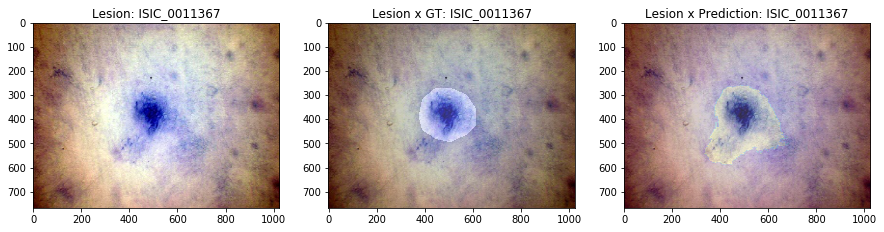

<Figure size 432x288 with 0 Axes>

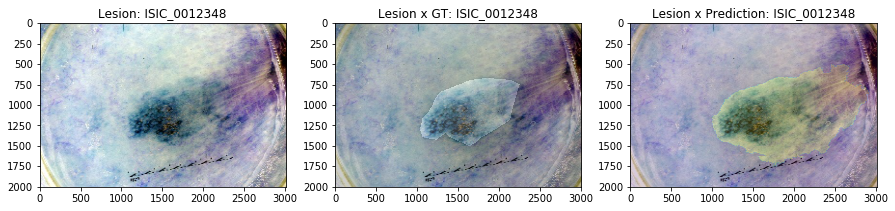

<Figure size 432x288 with 0 Axes>

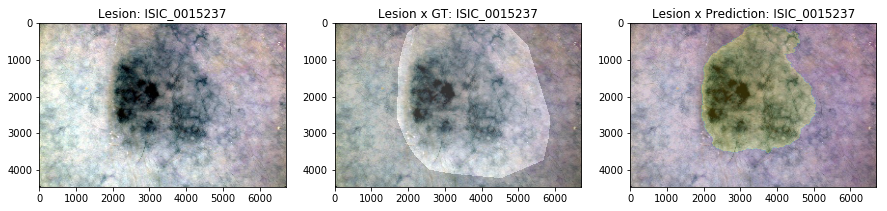

<Figure size 432x288 with 0 Axes>

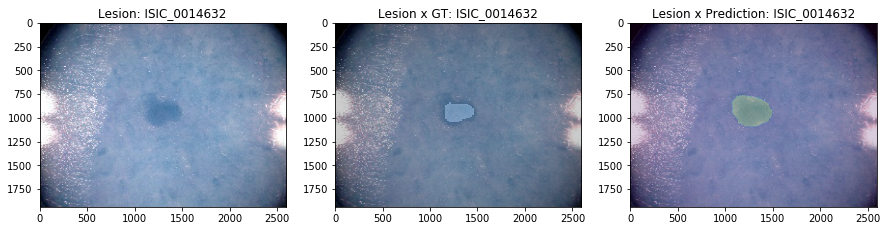

<Figure size 432x288 with 0 Axes>

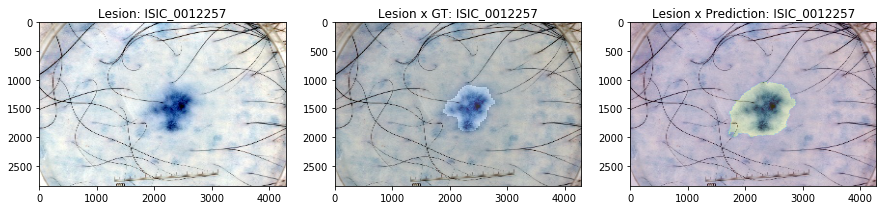

<Figure size 432x288 with 0 Axes>

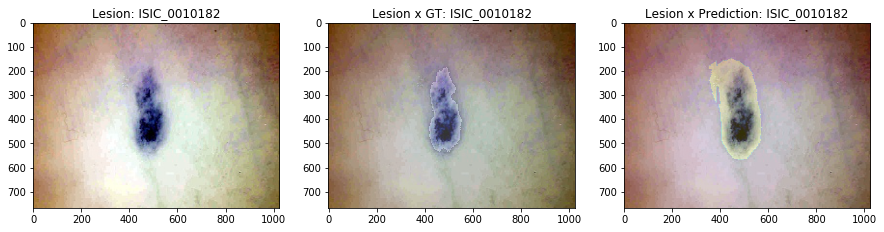

<Figure size 432x288 with 0 Axes>

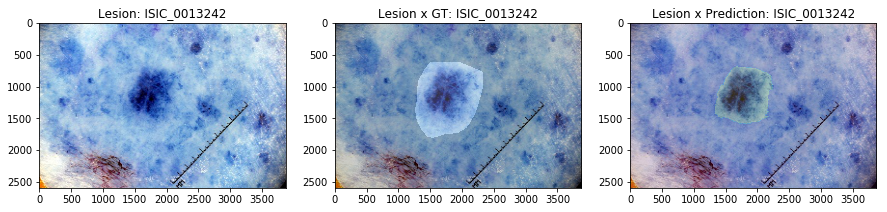

<Figure size 432x288 with 0 Axes>

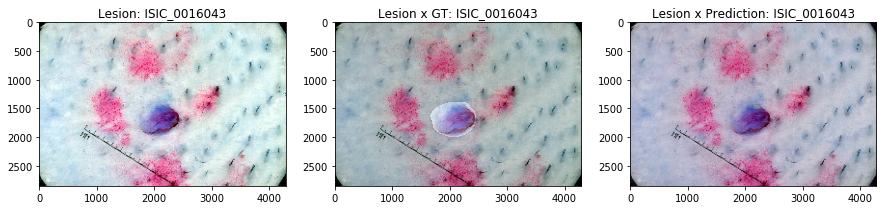

<Figure size 432x288 with 0 Axes>

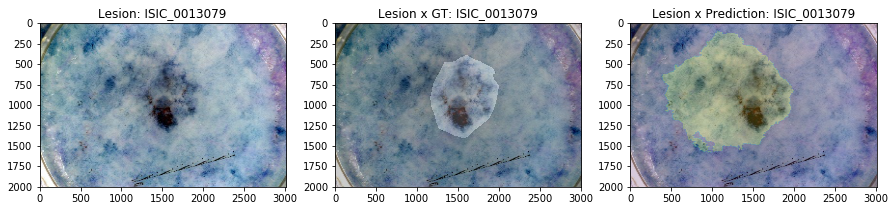

<Figure size 432x288 with 0 Axes>

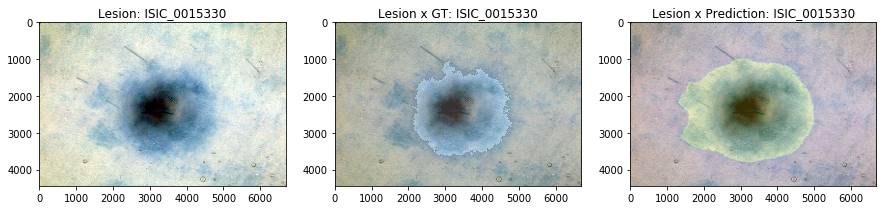

<Figure size 432x288 with 0 Axes>

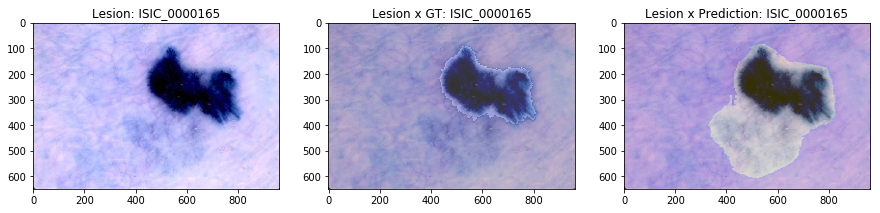

<Figure size 432x288 with 0 Axes>

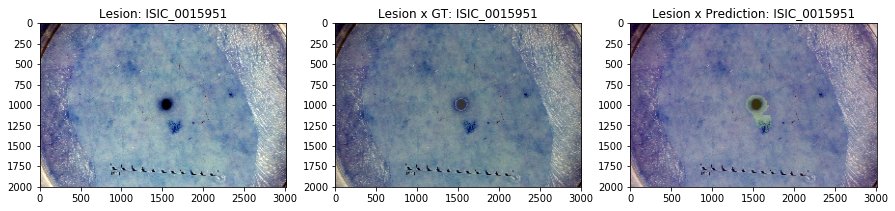

<Figure size 432x288 with 0 Axes>

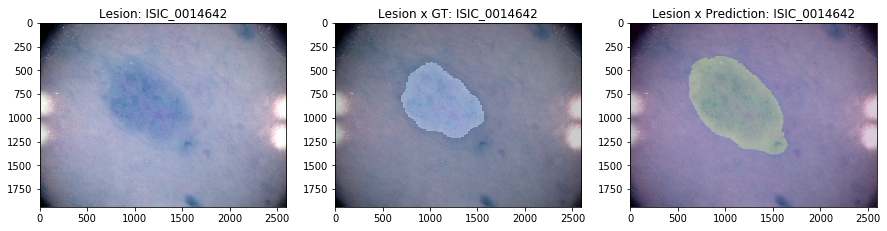

<Figure size 432x288 with 0 Axes>

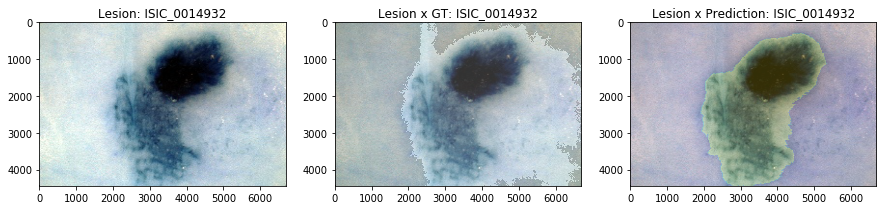

<Figure size 432x288 with 0 Axes>

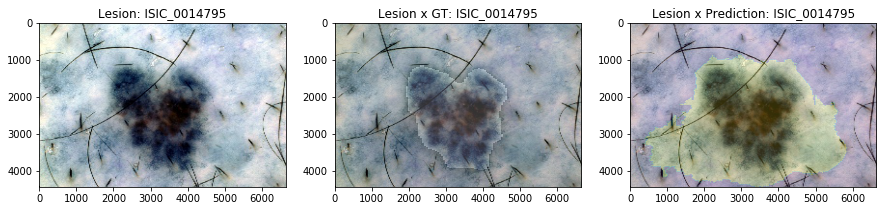

<Figure size 432x288 with 0 Axes>

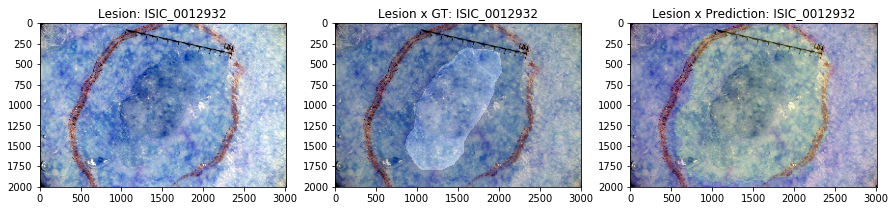

<Figure size 432x288 with 0 Axes>

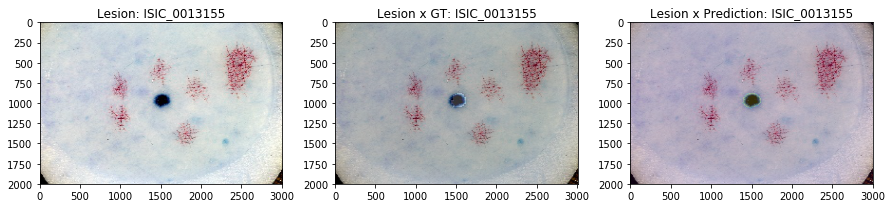

<Figure size 432x288 with 0 Axes>

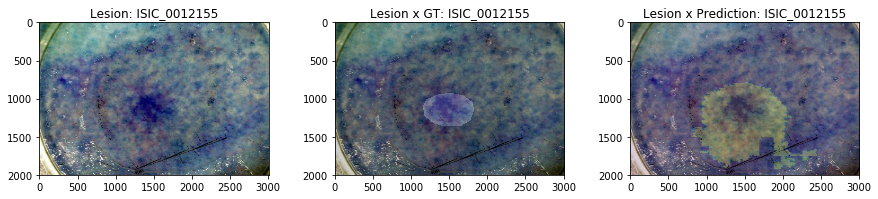

<Figure size 432x288 with 0 Axes>

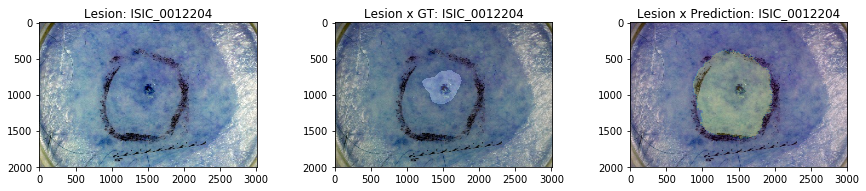

<Figure size 432x288 with 0 Axes>

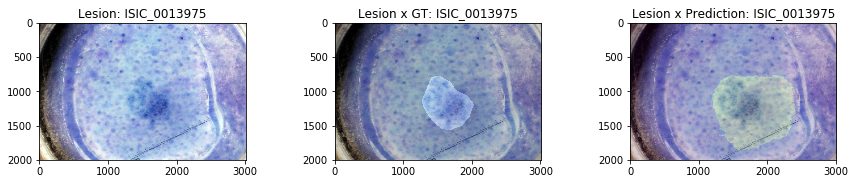

<Figure size 432x288 with 0 Axes>

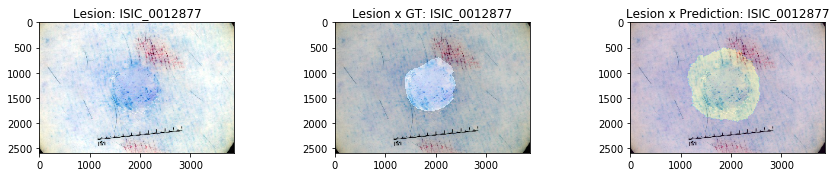

<Figure size 432x288 with 0 Axes>

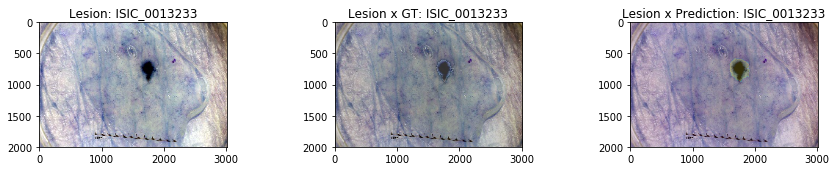

<Figure size 432x288 with 0 Axes>

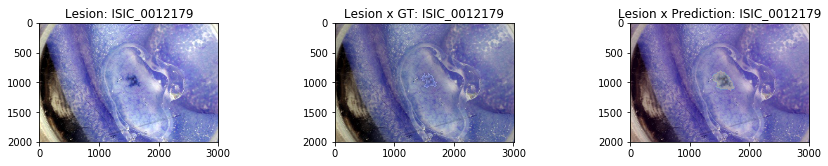

<Figure size 432x288 with 0 Axes>

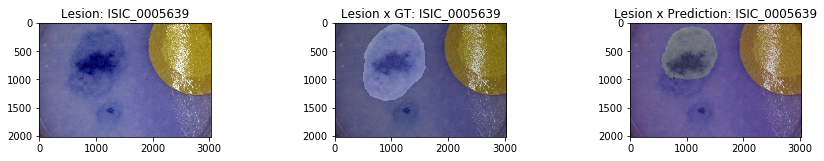

<Figure size 432x288 with 0 Axes>

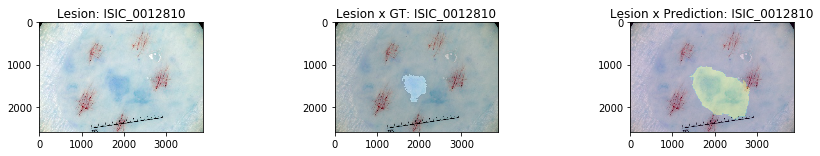

<Figure size 432x288 with 0 Axes>

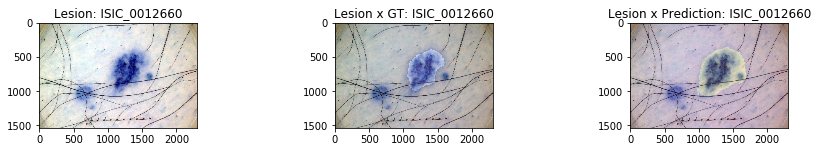

<Figure size 432x288 with 0 Axes>

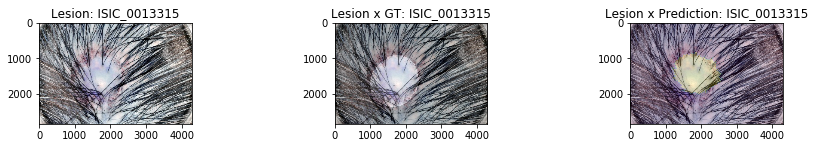

<Figure size 432x288 with 0 Axes>

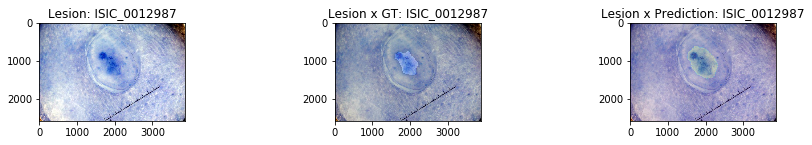

<Figure size 432x288 with 0 Axes>

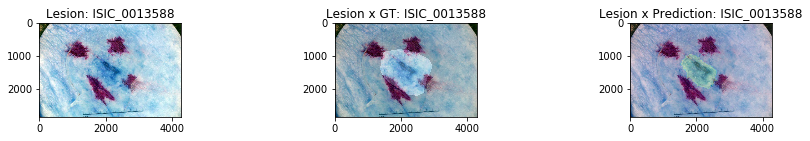

<Figure size 432x288 with 0 Axes>

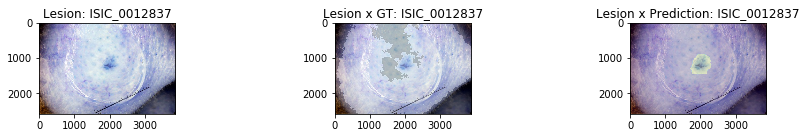

<Figure size 432x288 with 0 Axes>

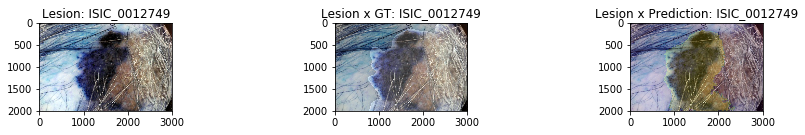

<Figure size 432x288 with 0 Axes>

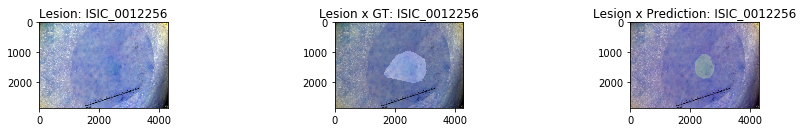

<Figure size 432x288 with 0 Axes>

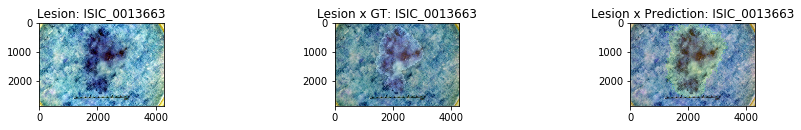

<Figure size 432x288 with 0 Axes>

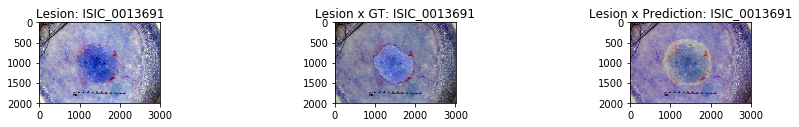

<Figure size 432x288 with 0 Axes>

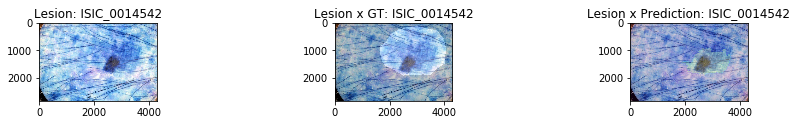

<Figure size 432x288 with 0 Axes>

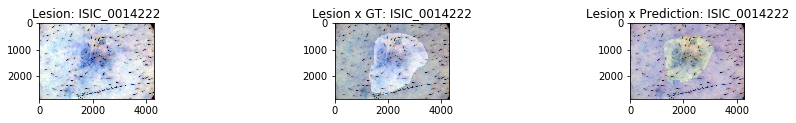

<Figure size 432x288 with 0 Axes>

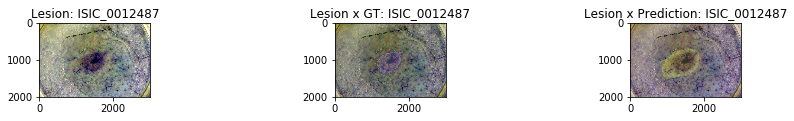

<Figure size 432x288 with 0 Axes>

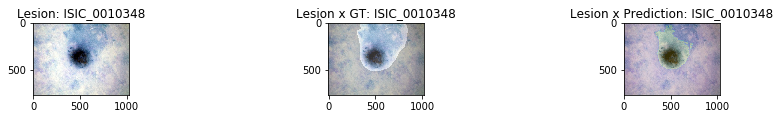

<Figure size 432x288 with 0 Axes>

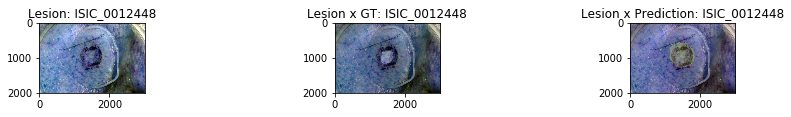

<Figure size 432x288 with 0 Axes>

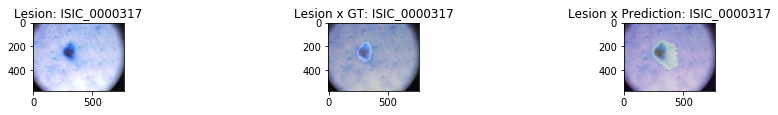

<Figure size 432x288 with 0 Axes>

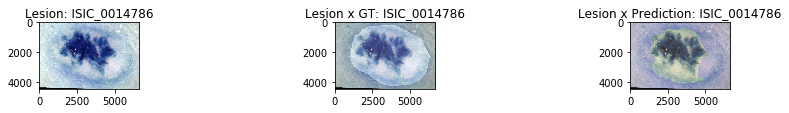

<Figure size 432x288 with 0 Axes>

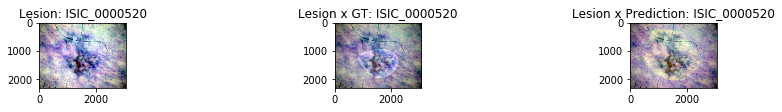

<Figure size 432x288 with 0 Axes>

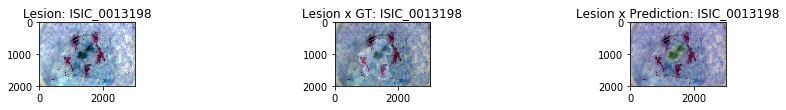

<Figure size 432x288 with 0 Axes>

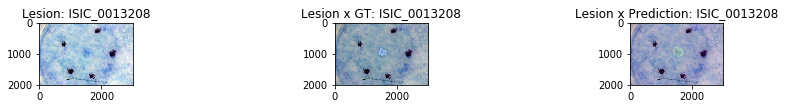

<Figure size 432x288 with 0 Axes>

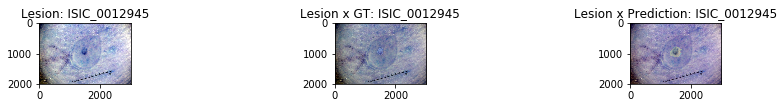

<Figure size 432x288 with 0 Axes>

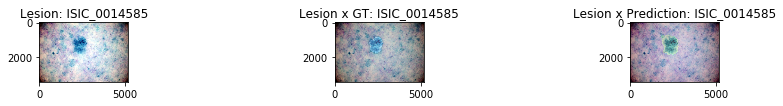

<Figure size 432x288 with 0 Axes>

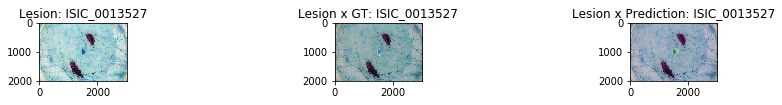

<Figure size 432x288 with 0 Axes>

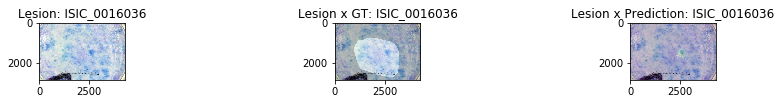

<Figure size 432x288 with 0 Axes>

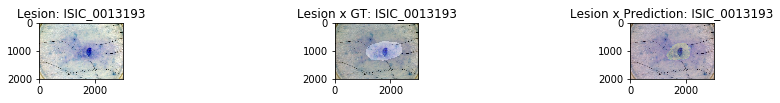

<Figure size 432x288 with 0 Axes>

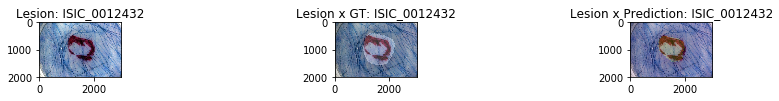

<Figure size 432x288 with 0 Axes>

In [135]:
i = 0
for j in range(len(jacs)):
    if jacs[j]< 0.65:
        fname = fnames[j].split('/')[-1].replace('.jpg', '')
        plt.figure(figsize=(15,60))
        plt.subplot(i+1,3,1).set_title(f'Lesion: {fname}')
        plt.imshow(X[j])
        plt.subplot(i+1,3,2).set_title(f'Lesion x GT: {fname}')
        plt.imshow(X[j])
        plt.imshow(Y[j], alpha=0.2)
        plt.subplot(i+1,3,3).set_title(f'Lesion x Prediction: {fname}')
        plt.imshow(X[j])
        plt.imshow(P[j], alpha=0.2)
        i+=1
        plt.show()
        plt.clf()

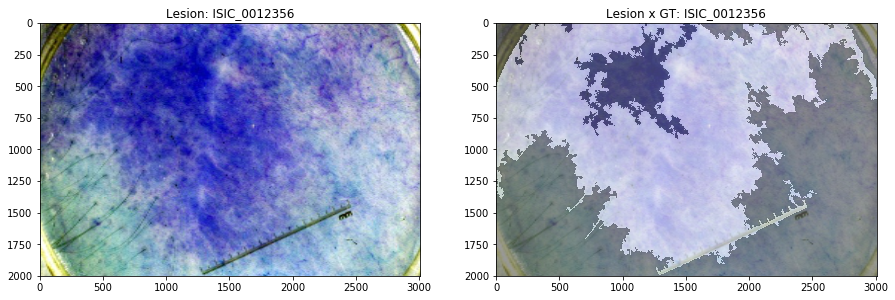

<Figure size 432x288 with 0 Axes>

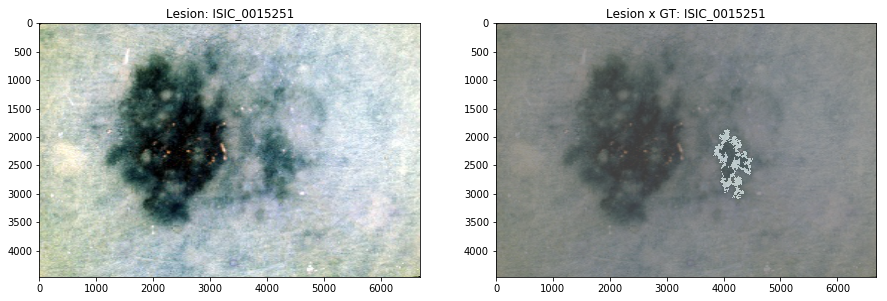

<Figure size 432x288 with 0 Axes>

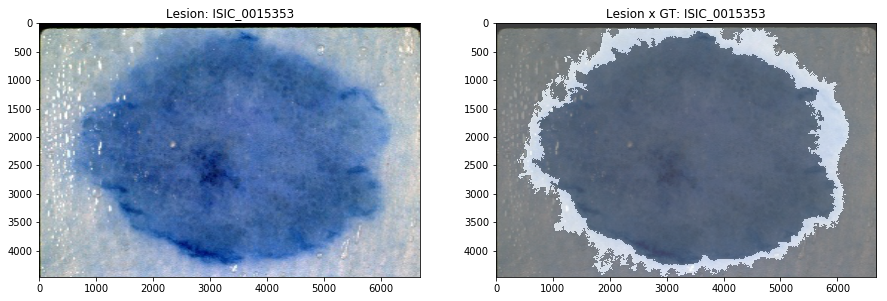

<Figure size 432x288 with 0 Axes>

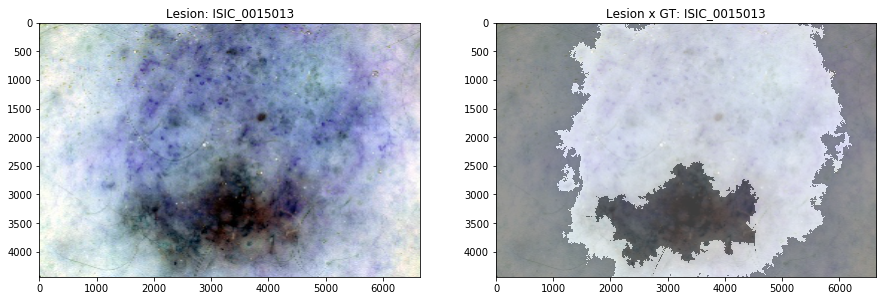

<Figure size 432x288 with 0 Axes>

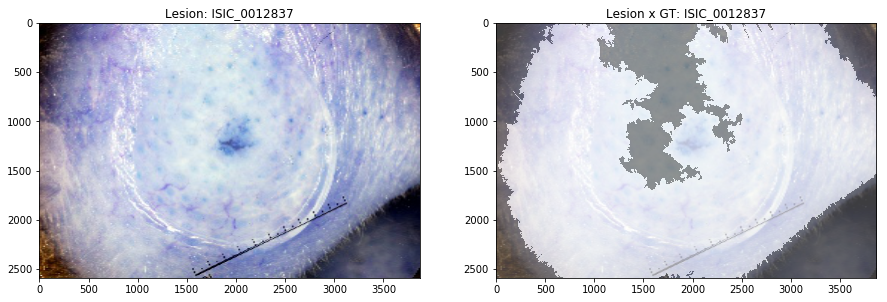

<Figure size 432x288 with 0 Axes>

In [145]:
strange = ['ISIC_0012356','ISIC_0015251','ISIC_0015353','ISIC_0015013','ISIC_0012837']
X = []
Y = []
for i, filename in enumerate(strange):
    row = df.loc[df.image_name==filename]
    height = row.height.item()
    width = row.width.item()
    x = cv2.imread(f'./Task1/Training_Balanced_256/{filename}.jpg')
    y = cv2.imread(f'./Task1/Training_GT/{filename}_segmentation.png')
    x = cv2.resize(x, (width, height))
    X.append(x)
    Y.append(y)
X = np.asarray(X)
Y = np.asarray(Y)

i = 0
for j in range(len(strange)):
    fname = strange[j]
    plt.figure(figsize=(15,60))
    plt.subplot(j+1,2,1).set_title(f'Lesion: {fname}')
    plt.imshow(X[j])
    plt.subplot(j+1,2,2).set_title(f'Lesion x GT: {fname}')
    plt.imshow(X[j], alpha=0.6)
    plt.imshow(Y[j], alpha=0.4)
    plt.show()
    plt.clf()

In [154]:
model_meta[resnet34]

[8, 6]

## Check Results

In [ ]:
fig, axes = plt.subplots(4, 4, figsize=(9, 6))
for i,ax in enumerate(axes.flat):
    ax = show_img(ims[i], ax=ax)
    show_img(im_masks[i][...,0], ax=ax, alpha=0.4)
plt.tight_layout(pad=0.05)

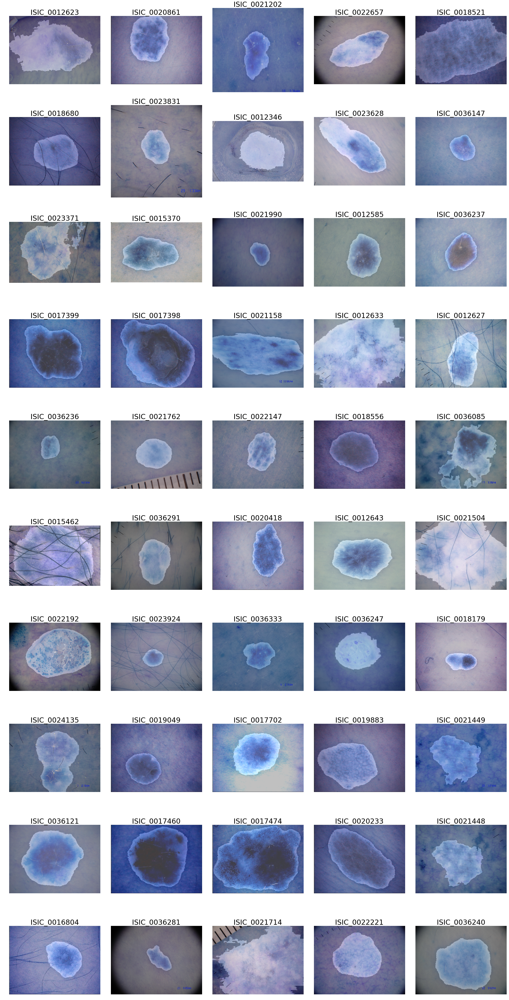

In [119]:
filenames = glob.glob(f'./Task1/Validation_Input/*')
fig, axes = plt.subplots(10, 5, figsize=(30, 60))
for i,ax in enumerate(axes.flat):
    fname = filenames[i].split('/')[-1].replace('.jpg', '')
    im = cv2.imread(filenames[i])
    ax.set_title(f'{fname}', fontsize=30)
    mask = cv2.imread(f'./Task1/results/{fname}_segmentation.png')
    ax = show_img(im, ax=ax)
    show_img(mask, ax=ax, alpha=0.4)
plt.tight_layout(pad=0.05)

In [ ]:
nn.modules.loss.

In [149]:
torch.__version__

'0.3.1'